In [1]:
# Initialize Otter
import otter
grader = otter.Notebook("lab4.ipynb")

In [2]:
# Mute Altair Warnings
import warnings
warnings.filterwarnings(
    "ignore",
    message="You passed a `<class 'narwhals.stable.v1.DataFrame'>` to `is_pandas_dataframe`"
)

## 0.550181, F1 Score

# Lab 4: Putting it all together in a mini project

For this lab, **you can choose to work alone or in a group of up to three students**. You are in charge of how you want to work and who you want to work with. Maybe you really want to go through all the steps of the ML process yourself or maybe you want to practice your collaboration skills, it is up to you! Just remember to indicate who your group members are (if any) when you submit on Gradescope. If you choose to work in a group, you only need to use one GitHub repo (you can create one on github.ubc.ca and set the visibility to "public"). If it takes a prohibitively long time to run any of the steps on your laptop, it is OK if you sample the data to reduce the runtime, just make sure you write a note about this.

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## Submission instructions
rubric={mechanics}

<p>You receive marks for submitting your lab correctly, please follow these instructions:</p>

<ul>
  <li><a href="https://ubc-mds.github.io/resources_pages/general_lab_instructions/">
      Follow the general lab instructions.</a></li>
  <li><a href="https://github.com/UBC-MDS/public/tree/master/rubric">
      Click here to view a description of the rubrics used to grade the questions</a></li>
  <li>Make at least three commits.</li>
  <li>Push your <code>.ipynb</code> file to your GitHub repository for this lab and upload it to Gradescope.</li>
    <ul>
      <li>Before submitting, make sure you restart the kernel and rerun all cells.</li>
    </ul>
  <li>Make sure to only make one gradescope submission per group, and to assign all group members on gradescope at submission time.</li>
  <li>Also upload a <code>.pdf</code> export of the notebook to facilitate grading of manual questions (preferably WebPDF, you can select two files when uploading to gradescope)</li>
  <li>Don't change any variable names that are given to you, don't move cells around, and don't include any code to install packages in the notebook.</li>
  <li>The data you download for this lab <b>SHOULD NOT BE PUSHED TO YOUR REPOSITORY</b> (there is also a <code>.gitignore</code> in the repo to prevent this).</li>
  <li>Include a clickable link to your GitHub repo for the lab just below this cell
    <ul>
      <li>It should look something like this https://github.ubc.ca/MDS-2020-21/DSCI_531_labX_yourcwl.</li>
    </ul>
  </li>
</ul>
</div>


_Points:_ 2

https://github.ubc.ca/mds-2025-26/DSCI_573_lab4_snalyf

<!-- END QUESTION -->

## Introduction <a name="in"></a>

In this lab you will be working on an open-ended mini-project, where you will put all the different things you have learned so far in 571 and 573 together to solve an interesting problem.

A few notes and tips when you work on this mini-project: 

#### Tips
1. Since this mini-project is open-ended there might be some situations where you'll have to use your own judgment and make your own decisions (as you would be doing when you work as a data scientist). Make sure you explain your decisions whenever necessary. 
2. **Do not include everything you ever tried in your submission** -- it's fine just to have your final code. That said, your code should be reproducible and well-documented. For example, if you chose your hyperparameters based on some hyperparameter optimization experiment, you should leave in the code for that experiment so that someone else could re-run it and obtain the same hyperparameters, rather than mysteriously just setting the hyperparameters to some (carefully chosen) values in your code. 
3. If you realize that you are repeating a lot of code try to organize it in functions. Clear presentation of your code, experiments, and results is the key to be successful in this lab. You may use code from lecture notes or previous lab solutions with appropriate attributions. 

#### Assessment
We don't have some secret target score that you need to achieve to get a good grade. **You'll be assessed on demonstration of mastery of course topics, clear presentation, and the quality of your analysis and results.** For example, if you just have a bunch of code and no text or figures, that's not good. If you instead try several reasonable approaches and you have clearly motivated your choices, but still get lower model performance than your friend, don't sweat it.


#### A final note
Finally, the style of this "project" is different from other assignments. It'll be up to you to decide when you're "done" -- in fact, this is one of the hardest parts of real projects. But please don't spend WAY too much time on this... perhaps "several hours" but not "many hours" is a good guideline for a high quality submission. Of course if you're having fun you're welcome to spend as much time as you want! But, if so, try not to do it out of perfectionism or getting the best possible grade. Do it because you're learning and enjoying it. Students from the past cohorts have found such kind of labs useful and fun and we hope you enjoy it as well. 

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 1. Pick your problem and explain the prediction problem <a name="1"></a>
rubric={reasoning}

In this mini project, you will pick one of the following problems: 

1. A classification problem of predicting whether a credit card client will default or not. For this problem, you will use [Default of Credit Card Clients Dataset](https://www.kaggle.com/uciml/default-of-credit-card-clients-dataset). In this data set, there are 30,000 examples and 24 features, and the goal is to estimate whether a person will default (fail to pay) their credit card bills; this column is labeled "default.payment.next.month" in the data. The rest of the columns can be used as features. You may take some ideas and compare your results with [the associated research paper](https://www.sciencedirect.com/science/article/pii/S0957417407006719), which is available through [the UBC library](https://www.library.ubc.ca/). 

OR 

2. A regression problem of predicting `reviews_per_month`, as a proxy for the popularity of the listing with [New York City Airbnb listings from 2019 dataset](https://www.kaggle.com/dgomonov/new-york-city-airbnb-open-data). Airbnb could use this sort of model to predict how popular future listings might be before they are posted, perhaps to help guide hosts create more appealing listings. In reality they might instead use something like vacancy rate or average rating as their target, but we do not have that available here.

**Your tasks:**

1. Spend some time understanding the problem and what each feature means. Write a few sentences on your initial thoughts on the problem and the dataset. 
2. Download the dataset and read it as a pandas dataframe. 
3. Carry out any preliminary preprocessing, if needed (e.g., changing feature names, handling of NaN values etc.)
    
</div>


_Points:_ 3

_The data set I chose is the Default of Credit Card Clients Dataset. I am using this data set to predict whether the client will default the payment based on the features selected. The predict is in binary formate, 0 indicates not default the payment while 1 indicates default the payment._

_After an inital inspection, there are intotal of 25 columns in which `default.payment.next.month` is the target. Among all left 24 columns, `ID` column is a serial column that does not contain any information. The other 23 columns are meaning features that contains no NA values._

_Furthermore, among the 23 features lefted, `SEX`, `EDUCATION`, `MARRIGAGE`, `PAY_x` are categorical features while other features are numeric features._

1. `SEX`: Contains two levels, 1 for male, 2 for female.
2. `Education`: Contains 6 levels, 1 for graduate school, 2 for university, 3 for high school, 4 for others, 5 and 6 are unknown. The 5 and 6 will be furtherly explained in the EDA process.
3. `Marriage`: Contains 3 levels, 1 for marries, 2 for single, 3 for others.
4. `PAY_x`: Where x indicates an integer from 0 - 6 indicating repayment status fron September, 0, to April, 6.

_I renamed `default.payment.next.month` into `target` for furture uses, just to save some time and make the dataset more clear._

In [3]:
import pandas as pd
import numpy as np

# Read Dataset
dataset = pd.read_csv('data/UCI_Credit_Card.csv').rename({'default.payment.next.month': 'target'}, axis = 1).drop('ID', axis = 1)

# Changing categorical value to categorical to EDA
cat_cols = ['SEX', 'EDUCATION', 'MARRIAGE', 'PAY_0', 'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'target']
dataset[cat_cols] = dataset[cat_cols].astype('category')

In [4]:
dataset

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,target
0,20000.0,2,2,1,24,2,2,-1,-1,-2,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,120000.0,2,2,2,26,-1,2,0,0,0,...,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,90000.0,2,2,2,34,0,0,0,0,0,...,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
3,50000.0,2,2,1,37,0,0,0,0,0,...,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
4,50000.0,1,2,1,57,-1,0,-1,0,0,...,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,220000.0,1,3,1,39,0,0,0,0,0,...,88004.0,31237.0,15980.0,8500.0,20000.0,5003.0,3047.0,5000.0,1000.0,0
29996,150000.0,1,3,2,43,-1,-1,-1,-1,0,...,8979.0,5190.0,0.0,1837.0,3526.0,8998.0,129.0,0.0,0.0,0
29997,30000.0,1,2,2,37,4,3,2,-1,0,...,20878.0,20582.0,19357.0,0.0,0.0,22000.0,4200.0,2000.0,3100.0,1
29998,80000.0,1,3,1,41,1,-1,0,0,0,...,52774.0,11855.0,48944.0,85900.0,3409.0,1178.0,1926.0,52964.0,1804.0,1


In [5]:
# Inspection on the dataset
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 24 columns):
 #   Column     Non-Null Count  Dtype   
---  ------     --------------  -----   
 0   LIMIT_BAL  30000 non-null  float64 
 1   SEX        30000 non-null  category
 2   EDUCATION  30000 non-null  category
 3   MARRIAGE   30000 non-null  category
 4   AGE        30000 non-null  int64   
 5   PAY_0      30000 non-null  category
 6   PAY_2      30000 non-null  category
 7   PAY_3      30000 non-null  category
 8   PAY_4      30000 non-null  category
 9   PAY_5      30000 non-null  category
 10  PAY_6      30000 non-null  category
 11  BILL_AMT1  30000 non-null  float64 
 12  BILL_AMT2  30000 non-null  float64 
 13  BILL_AMT3  30000 non-null  float64 
 14  BILL_AMT4  30000 non-null  float64 
 15  BILL_AMT5  30000 non-null  float64 
 16  BILL_AMT6  30000 non-null  float64 
 17  PAY_AMT1   30000 non-null  float64 
 18  PAY_AMT2   30000 non-null  float64 
 19  PAY_AMT3   30000 non-null

In [6]:
dataset.describe()

,LIMIT_BAL,AGE,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6
count,30000.000000,30000.000000,30000.000000,30000.000000,3.000000e+04,30000.000000,30000.000000,30000.000000,30000.000000,3.000000e+04,30000.00000,30000.000000,30000.000000,30000.000000
mean,167484.322667,35.485500,51223.330900,49179.075167,4.701315e+04,43262.948967,40311.400967,38871.760400,5663.580500,5.921163e+03,5225.68150,4826.076867,4799.387633,5215.502567
std,129747.661567,9.217904,73635.860576,71173.768783,6.934939e+04,64332.856134,60797.155770,59554.107537,16563.280354,2.304087e+04,17606.96147,15666.159744,15278.305679,17777.465775
min,10000.000000,21.000000,-165580.000000,-69777.000000,-1.572640e+05,-170000.000000,-81334.000000,-339603.000000,0.000000,0.000000e+00,0.00000,0.000000,0.000000,0.000000
25%,50000.000000,28.000000,3558.750000,2984.750000,2.666250e+03,2326.750000,1763.000000,1256.000000,1000.000000,8.330000e+02,390.00000,296.000000,252.500000,117.750000
50%,140000.000000,34.000000,22381.500000,21200.000000,2.008850e+04,19052.000000,18104.500000,17071.000000,2100.000000,2.009000e+03,1800.00000,1500.000000,1500.000000,1500.000000
75%,240000.000000,41.000000,67091.000000,64006.250000,6.016475e+04,54506.000000,50190.500000,49198.250000,5006.000000,5.000000e+03,4505.00000,4013.250000,4031.500000,4000.000000
max,1000000.000000,79.000000,964511.000000,983931.000000,1.664089e+06,891586.000000,927171.000000,961664.000000,873552.000000,1.684259e+06,896040.00000,621000.000000,426529.000000,528666.000000


In [7]:
# replace 0s and 6s in the dfs into 5. WTF is a 0?

dataset['EDUCATION'] = dataset['EDUCATION'].apply(lambda x: 5 if x in [0, 5, 6] else x)

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 2. Data splitting <a name="2"></a>
rubric={reasoning}

**Your tasks:**

1. Split the data into train and test portions.

> Make the decision on the `test_size` based on the capacity of your laptop. 
    
</div>


_Points:_ 1

The data set itself contains in total of 30,000 data points, 80/20 will be a good split size so that the model can have more data to leanr while the test size still has a decent amount of data points to test the generalization of the model.

In [8]:
# Train test split
from sklearn.model_selection import train_test_split
train, test = train_test_split(dataset, train_size = 0.8, random_state = 573)

X_train = train.drop('target', axis = 1)
y_train = train['target']

X_test = test.drop('target', axis = 1)
y_test = test['target']

X_train, y_train, X_test, y_test

(       LIMIT_BAL SEX  EDUCATION MARRIAGE  AGE PAY_0 PAY_2 PAY_3 PAY_4 PAY_5  \
 7359     20000.0   1          3        1   49     0     0     0     0    -1   
 16848    20000.0   1          3        2   40     0     0     0     0     0   
 29592    30000.0   1          1        2   49     0     0     0     2     0   
 20636   100000.0   1          3        2   30     0     0     0     0     0   
 26275   280000.0   2          1        1   37    -1    -1    -1    -1     0   
 ...          ...  ..        ...      ...  ...   ...   ...   ...   ...   ...   
 8144     50000.0   1          1        2   23     0     0     2     2     0   
 14870   150000.0   1          1        2   44     1     2    -1    -1     0   
 29361   310000.0   1          3        2   28    -1     2    -1    -1    -1   
 9822     20000.0   1          3        2   49     0     0     0    -1     0   
 16928    50000.0   1          1        2   50     0     0     0    -1    -1   
 
        ... BILL_AMT3  BILL_AMT4  BILL

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 3. EDA <a name="3"></a>
rubric={viz,reasoning}
    
Perform exploratory data analysis on the train set.

**Your tasks:**

1. Include at least two summary statistics and two visualizations that you find useful, and accompany each one with a sentence explaining it.
2. Summarize your initial observations about the data. 
3. Pick appropriate metric/metrics for assessment. 
    
</div>


_Points:_ 6

1. Distributions & log distributions: In the first distribution plots, we can see that most of the feature are identical in terms of repay decision except for `LIMIT_BAL`, which indicates how much credit the client has. According to the plot, those who not default the payment are more likely to have a higher `LIMIT_BAL` compare with those who default the payment, this makes sense because the bank will automatically adjust their credit level if they default the payment. Furthermore, for a thothrough inspection on the numeric features, I used log to scale down the range, we can see that most of the log distributions follows a left-skewed normal distributions, among them, those who default the payment will have more on `BILL_AMT` which indicates the credit they spent for the current month and less `PAY_AMT` which indicates the credit they repay for last month credit usage, for those who does not default is the opposite.
2. Distribution of Categorical values: In the first glance, it is noticeable that the train set has a class imbalance where we are having more 0s in the target compare with 1s. Moreover, we can see that most of the `PAY_x` has the same distribution where most of the clients pay back the credit on time (if -2 and 0 count as payback on time). However in `PAY_0`, we see an increase in the amount of client who choose to default a month. This is due to unknown reason.
3. Numeric Correlation: As we can see in the correlation plot, most of the `PAY_AMTx` and `BILL_AMTx` are highly correlated which indicate the multicollinearities between them. This is understandable because the dataset is a time-series dataset where `PAY_AMTx` and `BILL_AMTx` will be highly correlated with last-month's variable. A further linearity EDA is shown in the pairwise scatter plot.

In a summary, the train set itself contains obvious class imbalance where having more 0s compare with 1s, meanwhile, the train set contains serious multicollinearities between variables which may confuse the linear model in the furture.

For this task, I will choose F1 score as the major scoring metric, this is because F1 score represents the combined metrics for Precision and Recall, which are the two metrics that we want to maximize. Also, I will also include accuracy, precision, and recall score because I want to interpret the F1 score.

In [9]:
# Distribution without log
import altair_ally as aly
aly.alt.data_transformers.enable('vegafusion')

aly.dist(train, color = 'target').resolve_scale(y = 'independent')

alt.ConcatChart(...)

In [10]:
# Distribution with log so that we can see the comparisions.
import math

log_cols = [col for col in train.columns if 'AMT' in col or 'LIMIT' in col]
log_train = train[log_cols + ['target']]

for col in log_cols:
    log_train[col] = log_train[col].apply(lambda x: np.log1p(x) if x > 0 else np.nan)

aly.dist(log_train, color = 'target').resolve_scale(y = 'independent')

/var/folders/0d/79nrp42n0jj9zj4fvsgb49b40000gn/T/ipykernel_48718/2120864246.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  log_train[col] = log_train[col].apply(lambda x: np.log1p(x) if x > 0 else np.nan)


alt.ConcatChart(...)

In [11]:
# Distribution of categoricals
import altair as alt

cat_train = train[cat_cols].melt(id_vars = 'target', var_name = 'variable', value_name = 'value')

alt.Chart(cat_train).mark_bar().encode(
    x = alt.X('value:N').title('Category'),
    y = alt.Y('count()').title('Count'),
    color = 'target'
).properties(
    width = 150,
    height = 150
).facet(
    'variable:N',
    columns = 3
)

alt.FacetChart(...)

In [12]:
# Correlations between numeric variables

aly.corr(train)

alt.ConcatChart(...)

In [13]:
# Visualize pairwise scatterplots
columns_with_at_least_one_high_corr = [
    "BILL_AMT6",
    "BILL_AMT5",
    "BILL_AMT4",
    "BILL_AMT3",
    "BILL_AMT2",
    "BILL_AMT1",
    "target"
]

aly.pair(train[columns_with_at_least_one_high_corr].sample(300), color = 'target')

alt.VConcatChart(...)

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-warning">

## 4. Feature engineering (Challenging)
rubric={reasoning}

**Your tasks:**

1. Carry out feature engineering. In other words, extract new features relevant for the problem and work with your new feature set in the following exercises. You may have to go back and forth between feature engineering and preprocessing.
    
</div>


_Points:_ 0.5

After the EDA process, it is reasonable to to following feature engineering:

1. `usage_rate`: we can not simply conclude the repayment decision if a client used lots of credit, what if he/she has way more credit than he/she used? Hence, I want to create a `usage_rate` that indicate how much credit they used in that month to the ratio of the total credit limit. This allows us to understand two variables in one.
2. `repay_rate`: This is also the same, we can not simply conclude the repayment decision if a client repays lots of money without obeserving the credit they spent last month.
3. `growth`: This indicates credit spent growth of the client in September 2005 compare with April 2005, this will show the expenses increase or decrease compare with before. However, an important shortage of doing so is that we did not count the repay amount into it so we don't know whether the client is actually spending less or they don't have enough credit to spend.
4. `avg_bill/pay`: We observed multicolinearities between `BILL_AMTx` and `PAY_AMTx`, where the multicolinearities will confuse the estimations. Hence, doing `avg` for both `BILL_AMT` and `PAY_AMT` will be a solution to multicolinearities.

Overall, some of the engineering can be done within the original dataset, some of them can not since it violates the golden rule. Hence, I will create a function to do the engineering to avoid violation on the golden rules.

In [14]:
def engineer(df):
    output = df
    bill_cols = ['BILL_AMT1', 'BILL_AMT2', 'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6']
    pay_cols = ['PAY_AMT1', 'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6']
    #usage_rate, replace 0 with 1 to avoid /0
    output['usage_rate'] = (output[bill_cols].sum(axis = 1) - output[pay_cols].sum(axis = 1))/df['LIMIT_BAL'].replace(0, 1)
    
    # repayment rate
    output['repayment_rate'] = output['PAY_AMT1']/(df['BILL_AMT2']).replace(0, 1)

    # growth in credit spent
    output['growth'] = output['BILL_AMT1'] - output['BILL_AMT6']

    # avg and std
    output['avg_bill'] = output[bill_cols].mean(axis = 1)
    output['avg_pay'] = output[pay_cols].mean(axis = 1)

    return output

In [15]:
X_train_eng = engineer(X_train)
X_test_eng = engineer(X_test)

In [16]:
X_train_eng.describe()

,LIMIT_BAL,EDUCATION,AGE,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,usage_rate,repayment_rate,growth,avg_bill,avg_pay
count,24000.000000,24000.000000,24000.000000,24000.000000,24000.000000,2.400000e+04,24000.000000,24000.000000,24000.000000,24000.000000,2.400000e+04,24000.000000,24000.000000,24000.000000,24000.000000,24000.000000,24000.000000,24000.000000,24000.000000,24000.000000
mean,166637.903333,1.851292,35.454958,50863.103917,48819.145542,4.670982e+04,42992.670625,39937.176083,38496.814458,5631.448375,5.872582e+03,5236.218875,4750.700708,4794.267792,5236.224375,2.002168,6.305021,12366.289458,44636.454396,5253.573674
std,129227.497408,0.782381,9.197219,73078.463787,70700.471576,6.911220e+04,63968.874274,60237.533490,58873.260040,15938.534290,2.248612e+04,17261.937805,14991.417631,15129.636201,18157.577834,2.046448,275.498710,43783.339391,62751.636485,9648.672322
min,10000.000000,1.000000,21.000000,-154973.000000,-69777.000000,-1.572640e+05,-170000.000000,-81334.000000,-339603.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,-4.481233,-497.800000,-428791.000000,-56043.166667,0.000000
25%,50000.000000,1.000000,28.000000,3555.750000,2966.000000,2.631250e+03,2301.000000,1702.750000,1229.000000,1000.000000,8.497500e+02,390.000000,281.750000,259.750000,97.750000,0.027461,0.036943,-2969.250000,4749.250000,1103.583333
50%,140000.000000,2.000000,34.000000,22109.000000,20739.500000,1.995550e+04,18968.500000,18067.000000,17003.000000,2100.000000,2.009000e+03,1800.000000,1500.000000,1500.000000,1500.000000,1.420180,0.062827,905.500000,20754.916667,2389.833333
75%,240000.000000,2.000000,41.000000,66611.750000,63338.000000,5.973500e+04,54049.000000,49891.750000,49037.000000,5002.000000,5.000000e+03,4500.000000,4000.000000,4051.000000,4000.000000,3.816093,0.538184,19765.250000,56846.666667,5570.833333
max,1000000.000000,5.000000,79.000000,964511.000000,983931.000000,1.664089e+06,891586.000000,927171.000000,961664.000000,493358.000000,1.684259e+06,896040.000000,528897.000000,426529.000000,528666.000000,31.221350,24437.000000,522478.000000,877313.833333,385692.000000


In [17]:
# Rerun the EDA:
aly.corr(X_train_eng)

alt.ConcatChart(...)

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 5. Preprocessing and transformations <a name="5"></a>
rubric={accuracy,reasoning}

**Your tasks:**

1. Identify different feature types and the transformations you would apply on each feature type. 
2. Define a column transformer, if necessary. 
    
</div>


_Points:_ 4

From the EDA process, we can see that multiple features are having multicolinearities, hence we can drop them out of the dataframe, however, we can also use feature selection to do so. I will drop it in the linear/logistic regression model so that it won't confuse the model too much.

In [18]:
from sklearn.preprocessing import StandardScaler, OneHotEncoder, OrdinalEncoder
from sklearn.pipeline import make_pipeline
from sklearn.compose import make_column_transformer

## Columntransformers
categorical_cols = ['SEX', 'MARRIAGE', 'PAY_0', 'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'EDUCATION']

drop_cols = [i for i in X_train_eng.columns if 'AMT' in i]

numeric_cols = [i for i in X_train_eng.columns if i not in categorical_cols + drop_cols]

preprocessor = make_column_transformer(
    (StandardScaler(), numeric_cols),
    (OneHotEncoder(handle_unknown = 'ignore', sparse_output = False), categorical_cols),
    ('drop', drop_cols)
)

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 6. Baseline model <a name="6"></a>
rubric={accuracy}

**Your tasks:**
1. Train a baseline model for your task and report its performance.
    
</div>


_Points:_ 2

Answer: Without any doubts, dummyclassifier is the worst performance model where having validate F1 score = 0, where accuracy = 0.78 due to class imbalance. This is only the baseline model.

In [19]:
from sklearn.dummy import DummyClassifier
from sklearn.model_selection import cross_validate

scoring = {
    'accuracy': 'accuracy',
    'recall': 'recall',
    'precision': 'precision',
    'f1': 'f1'
}
baseline = DummyClassifier()
cross_val_results = {}
cross_val_results['dummy'] = pd.DataFrame(cross_validate(baseline, X_train_eng, y_train, return_train_score = True, scoring = scoring)).agg(['mean', 'std']).round(3).T

/Users/snalyf/miniforge3/envs/573/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/Users/snalyf/miniforge3/envs/573/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/Users/snalyf/miniforge3/envs/573/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.sh

In [20]:
cross_val_results['dummy']

,mean,std
fit_time,0.002,0.000
score_time,0.004,0.001
test_accuracy,0.780,0.000
train_accuracy,0.780,0.000
test_recall,0.000,0.000
train_recall,0.000,0.000
test_precision,0.000,0.000
train_precision,0.000,0.000
test_f1,0.000,0.000
train_f1,0.000,0.000


<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 7. Linear models <a name="7"></a>
rubric={accuracy,reasoning}

**Your tasks:**

1. Try a linear model as a first real attempt. 
2. Carry out hyperparameter tuning to explore different values for the regularization hyperparameter. 
3. Report cross-validation scores along with standard deviation. 
4. Summarize your results.
    
</div>


_Points:_ 8

_The logistic regression model is performing average with an average F1 score of 0.533 on train set and 0.530 on validation set.  With validate precision = 0.489 and recall = 0.578. The scoring metrics tell us that the model's prediciton contains 48.9% TPs and 51.1 FPs, approximately half of the predictions are False Positive, for the recall, we are catching around 57.8% of the TPs, whilehaving 42.2% of the FNs. This is not a delightful result since both of the scores are quite mediocre. For the tuned logistic regression, it performs approximately the same._

In [21]:
from sklearn.linear_model import LogisticRegression

pipe = make_pipeline(preprocessor, LogisticRegression(max_iter = 1000, class_weight = 'balanced'))
cross_val_results['logreg'] = pd.DataFrame(cross_validate(pipe, X_train_eng, y_train, return_train_score = True, scoring = scoring)).agg(['mean', 'std']).round(3).T

In [22]:
cross_val_results['logreg']

,mean,std
fit_time,0.080,0.006
score_time,0.009,0.001
test_accuracy,0.774,0.003
train_accuracy,0.777,0.002
test_recall,0.578,0.020
train_recall,0.579,0.004
test_precision,0.489,0.006
train_precision,0.495,0.004
test_f1,0.530,0.012
train_f1,0.533,0.004


In [23]:
# HyperParameter Optimization
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import expon, lognorm, loguniform, randint, uniform, norm, randint
random_grid = { 
    "logisticregression__C": loguniform(1e-5, 1e5),
    "logisticregression__class_weight": [None, 'balanced']
}

lr_opt = RandomizedSearchCV(pipe, param_distributions = random_grid, n_jobs = -1, return_train_score = True, scoring = 'f1')
lr_opt.fit(X_train_eng, y_train)

,estimator,Pipeline(step..._iter=1000))])
,param_distributions,"{'logisticregression__C': <scipy.stats....t 0x396d2a7e0>, 'logisticregression__class_weight': [None, 'balanced']}"
,n_iter,10
,scoring,'f1'
,n_jobs,-1
,refit,True
,cv,None
,verbose,0
,pre_dispatch,'2*n_jobs'
,random_state,None
,error_score,nan


In [24]:
cross_val_results['logreg_tuned'] = pd.DataFrame(cross_validate(lr_opt, X_train_eng, y_train, return_train_score = True, scoring = scoring)).agg(['mean', 'std']).round(3).T

In [25]:
cross_val_results['logreg_tuned']

,mean,std
fit_time,1.848,0.203
score_time,0.008,0.001
test_accuracy,0.775,0.003
train_accuracy,0.778,0.002
test_recall,0.577,0.021
train_recall,0.578,0.004
test_precision,0.491,0.006
train_precision,0.495,0.004
test_f1,0.530,0.012
train_f1,0.534,0.004


<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 8. Different models <a name="8"></a>
rubric={accuracy,reasoning}

**Your tasks:**
1. Try out three other models aside from the linear model. 
2. Summarize your results in terms of overfitting/underfitting and fit and score times. Can you beat the performance of the linear model? 
    
</div>


_Points:_ 10

The three models I chose are from forest family, GradiantBoosting, HistgradientBossting, and XGBoosting. Since we have lots of features while most of them are highly correlated, a random forest model will not influenced by these features.

`SVC`: The validate F1 score is 0.532 while the train F1 score = 0.562, so no sign of overfitting, SVC balances the predictions with precision = 0.493 while maintain half of the recall 0.578, which means that the prediction contains 49.3% True positives and 50.7% of the predictions are False Positives, meanwhile, the predictions captured around 57.8% positives from all positive observations, remaining 42.2% FNs uncaptured. Compare to the linear regression, all of the scores are extremely similar. In terms of fit time, since we are passing more numerical cofounding variables into the model, we can see that the fit time 9.827 is higher than the logreg fit time of 0.085.

`HistGradientBoosting`: For HistGradientBoosting, the result shows that HistGradientBoosting trades precision with the recall where we have validate recall = 0.629 and validate precision = 0.429, with validate F1 score = 0.537, the train F1 score = 0.597 hence it is not a significant overfit sign based on the scores. The precision and recall score tells us among all the positives we predicted, 42.9%% are TPs while rest of them are FPs, on the other side, we are only capturing 62.9%% of all the TPs and rest of them are missed from our prediction.

`XGBoosting`: Similar with `HistGradientBoosting`, `XGBoosting` also can balance the weight through hyperparameter, by doing so, we can see a validate F1 score = 0.520 while the train F1 score is at 0.576, indicating the model is not overfit to the dataset, but also means that the performance is worse than the `HistGradientBoosting`. The model captures 56.8% of the TPs while leaving 43.2% un captured, and among all the predictions, only 47.9% are TPs while rest of them are FPs.

Among all the three tree models, we can tell that tree models are having quite similar score compare with logreg and logreg-tuned. While `SVC` has the slowest fit time and `XGBoosting` has the fastest fit time, but all of the tree models are slower than the log-reg due to having more features fit into the model.

In [26]:
## Columntransformers
categorical_cols = ['SEX', 'MARRIAGE', 'PAY_0', 'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'EDUCATION']
numeric_cols = [i for i in X_train_eng.columns if i not in categorical_cols + drop_cols]
drop_cols = [i for i in X_train_eng.columns if 'AMT' in i]
preprocessor_svc = make_column_transformer(
    (StandardScaler(), numeric_cols),
    (OneHotEncoder(handle_unknown = 'ignore', sparse_output = False), categorical_cols),
    ('drop', drop_cols)
)

In [27]:
# SVC
from sklearn.svm import SVC

pipe = make_pipeline(preprocessor_svc, SVC(class_weight = 'balanced', random_state = 573))
cross_val_results['SVC'] = pd.DataFrame(cross_validate(pipe, X_train_eng, y_train, return_train_score = True, scoring = scoring)).agg(['mean', 'std']).round(3).T

In [28]:
## Columntransformers
categorical_cols = ['SEX', 'MARRIAGE', 'PAY_0', 'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'EDUCATION']
pass_through = [i for i in X_train_eng.columns if i not in categorical_cols + drop_cols]
drop_cols = [i for i in X_train_eng.columns if 'AMT' in i]
preprocessor_tree = make_column_transformer(
    ('passthrough', pass_through),
    (OneHotEncoder(handle_unknown = 'ignore', sparse_output = False), categorical_cols),
    ('drop', drop_cols)
)

In [29]:
# HistGradientBoosting
from sklearn.ensemble import HistGradientBoostingClassifier
pipe = make_pipeline(preprocessor_tree, HistGradientBoostingClassifier(random_state = 573, class_weight = 'balanced'))
cross_val_results['HGB'] = pd.DataFrame(cross_validate(pipe, X_train_eng, y_train, return_train_score = True, scoring = scoring)).agg(['mean', 'std']).round(3).T

In [30]:
# XGBoosting
from xgboost import XGBClassifier

weight = np.sum(y_train == 0)/np.sum(y_train== 1)

pipe = make_pipeline(preprocessor_tree, XGBClassifier(scale_pos_weight = weight, random_state = 573))
cross_val_results['XGB'] = pd.DataFrame(cross_validate(pipe, X_train_eng, y_train, return_train_score = True, scoring = scoring)).agg(['mean', 'std']).round(3).T

In [31]:
pd.concat(cross_val_results, axis=1)

dummy        logreg        logreg_tuned           SVC         \
                  mean    std   mean    std         mean    std   mean    std   
fit_time         0.002  0.000  0.080  0.006        1.848  0.203  9.948  0.351   
score_time       0.004  0.001  0.009  0.001        0.008  0.001  3.741  0.142   
test_accuracy    0.780  0.000  0.774  0.003        0.775  0.003  0.776  0.004   
train_accuracy   0.780  0.000  0.777  0.002        0.778  0.002  0.790  0.002   
test_recall      0.000  0.000  0.578  0.020        0.577  0.021  0.578  0.016   
train_recall     0.000  0.000  0.579  0.004        0.578  0.004  0.611  0.006   
test_precision   0.000  0.000  0.489  0.006        0.491  0.006  0.493  0.008   
train_precision  0.000  0.000  0.495  0.004        0.495  0.004  0.520  0.004   
test_f1          0.000  0.000  0.530  0.012        0.530  0.012  0.532  0.011   
train_f1         0.000  0.000  0.533  0.004        0.534  0.004  0.562  0.004   

                   HGB           XGB         
                  mean    std   mean    std  
fit_time         0.964  0.221  0.161  0.005  
score_time       0.016  0.003  0.008  0.001  
test_accuracy    0.759  0.007  0.755  0.007  
train_accuracy   0.787  0.010  0.877  0.007  
test_recall      0.628  0.018  0.572  0.019  
train_recall     0.701  0.016  0.874  0.005  
test_precision   0.464  0.011  0.455  0.013  
train_precision  0.512  0.017  0.669  0.016  
test_f1          0.534  0.012  0.507  0.015  
train_f1         0.592  0.016  0.758  0.011

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-warning">

## 9. Feature selection (Challenging)
rubric={reasoning}

**Your tasks:**

Make some attempts to select relevant features. You may try `RFECV`, forward/backward selection or L1 regularization for this. Do the results improve with feature selection? Summarize your results. If you see improvements in the results, keep feature selection in your pipeline. If not, you may abandon it in the next exercises unless you think there are other benefits with using fewer features.
    
</div>


_Points:_ 0.5

_For XGB, we can see that the validate F1 score indeed increased a little 0.507 -> 0.511, triming the features to 49 features. I will abandon this selection be cause the improvement is not huge, no matter in score or the time, while keeping more features may influence the result in hyperparameter optimization._

In [32]:
# Make a pipeline for feature selection using RFECV based on f1 score
from sklearn.feature_selection import RFECV
from sklearn.ensemble import RandomForestClassifier

pipe = make_pipeline(
    preprocessor_tree, 
    RFECV(XGBClassifier(scale_pos_weight = weight, random_state = 573), scoring = 'f1')
)
pipe.fit(X_train_eng, y_train)

,steps,"[('columntransformer', ...), ('rfecv', ...)]"
,transform_input,None
,memory,None
,verbose,False
,transformers,"[('passthrough', ...), ('onehotencoder', ...), ...]"
,remainder,'drop'
,sparse_threshold,0.3
,n_jobs,None
,transformer_weights,None
,verbose,False
,verbose_feature_names_out,True


In [33]:
rfecv_step = pipe.named_steps['rfecv']

In [34]:
rfecv_step.cv_results_['mean_test_score'].max()

np.float64(0.5144469743172981)

In [35]:
pipe.named_steps["rfecv"].n_features_

np.int64(49)

In [36]:
pipe[0].get_feature_names_out()[pipe[-1].support_]

array(['passthrough__LIMIT_BAL', 'passthrough__AGE',
       'passthrough__usage_rate', 'passthrough__repayment_rate',
       'passthrough__growth', 'passthrough__avg_bill',
       'passthrough__avg_pay', 'onehotencoder__SEX_1',
       'onehotencoder__MARRIAGE_0', 'onehotencoder__MARRIAGE_1',
       'onehotencoder__MARRIAGE_2', 'onehotencoder__MARRIAGE_3',
       'onehotencoder__PAY_0_-2', 'onehotencoder__PAY_0_-1',
       'onehotencoder__PAY_0_0', 'onehotencoder__PAY_0_1',
       'onehotencoder__PAY_0_2', 'onehotencoder__PAY_0_3',
       'onehotencoder__PAY_0_4', 'onehotencoder__PAY_2_-2',
       'onehotencoder__PAY_2_-1', 'onehotencoder__PAY_2_0',
       'onehotencoder__PAY_2_2', 'onehotencoder__PAY_2_3',
       'onehotencoder__PAY_3_-2', 'onehotencoder__PAY_3_-1',
       'onehotencoder__PAY_3_0', 'onehotencoder__PAY_3_2',
       'onehotencoder__PAY_3_4', 'onehotencoder__PAY_4_-2',
       'onehotencoder__PAY_4_-1', 'onehotencoder__PAY_4_0',
       'onehotencoder__PAY_4_2', 'onehotenco

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 10. Hyperparameter optimization
rubric={accuracy,reasoning}

**Your tasks:**

Make some attempts to optimize hyperparameters for the models you've tried and summarize your results. In at least one case you should be optimizing multiple hyperparameters for a single model. You may use `sklearn`'s methods for hyperparameter optimization or fancier Bayesian optimization methods.  Briefly summarize your results.
  - [GridSearchCV](http://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html)   
  - [RandomizedSearchCV](http://scikit-learn.org/stable/modules/generated/sklearn.model_selection.RandomizedSearchCV.html)
  - [scikit-optimize](https://github.com/scikit-optimize/scikit-optimize) 
    
</div>


_Points:_ 6

`SVC`: For SVC, I did random grid search CV for hyperparameters C and gamma, as we can see in the result table, because of the fitting time, I adjust the iteration from 10 to 5. There is a clear sign indicating overfitting in the highest test score at 4th cv search, where validate f1 score 0.457 has a huge gap with train score 0.594. Since this is a random search, we can not guarantee the parameters are the best parameter, but it is reasonable to conjecture that the mean test f1 score will not be higher than 0.50 by observing the pattern from the table.

`HistGradientBoosting`: For HistGradientBoosting, I managed to search for the most important hyperparameters: `max_iter` - controlling the iterations, `learning_rate` - controlling the correction decision of the tree, and `max_leaf_nodes` - controlling the width of the tree. Based on the result, we can see that the highest validate f1 score stays around 0.466 while the train score stays around 0.50 - 0.52, which is not a sign of overfitting. However, the result is quite unsatisfying because it is even worse with the HGB model without hyperparameter optimization.

`XGBoosting`: For XGBoosting, I tried to adjust most of the hyperparameters including several important tree hyperparameters as well as the regularization hyperparameters. The result is delightful, the best hyperparameters leads the model to a less overfit meanwhile better f1 score performance compare with the non-optimized XGBoosting model. The validate f1 score = 0.539276 while the train f1 score = 0.582759. Which I will use tuned XGBoosting as my final model to present.

In [63]:
random_grid = {
    'svc__C': loguniform(1e-3, 1e3),
    'svc__gamma': loguniform(1e-4, 1e0)
}

pipe = make_pipeline(preprocessor_svc, SVC(random_state = 573))
svc_opt = RandomizedSearchCV(pipe, param_distributions = random_grid, n_jobs = -1, n_iter = 5, return_train_score = True, scoring = 'f1', random_state = 573)
svc_opt.fit(X_train_eng, y_train)

,estimator,Pipeline(step..._state=573))])
,param_distributions,"{'svc__C': <scipy.stats....t 0x15326e570>, 'svc__gamma': <scipy.stats....t 0x15326e630>}"
,n_iter,5
,scoring,'f1'
,n_jobs,-1
,refit,True
,cv,None
,verbose,0
,pre_dispatch,'2*n_jobs'
,random_state,573
,error_score,nan


In [64]:
pd.DataFrame(svc_opt.cv_results_)[['mean_test_score', 'mean_train_score']].sort_values('mean_test_score', ascending = False)

,mean_test_score,mean_train_score
0,0.437882,0.498593
2,0.431277,0.432049
4,0.423602,0.484042
3,0.416644,0.416989
1,0.000000,0.000000


In [65]:
random_grid = {
    'histgradientboostingclassifier__max_iter': randint(100, 1000),
    'histgradientboostingclassifier__learning_rate': loguniform(0.001, 0.3),
    'histgradientboostingclassifier__max_leaf_nodes': randint(15, 255)
}

pipe = make_pipeline(preprocessor_tree, HistGradientBoostingClassifier(random_state = 573))
hgb_opt = RandomizedSearchCV(pipe, param_distributions = random_grid, n_jobs = -1, return_train_score = True, scoring = 'f1', random_state = 573)
hgb_opt.fit(X_train_eng, y_train)

,estimator,Pipeline(step..._state=573))])
,param_distributions,"{'histgradientboostingclassifier__learning_rate': <scipy.stats....t 0x15316df40>, 'histgradientboostingclassifier__max_iter': <scipy.stats....t 0x15316e4b0>, 'histgradientboostingclassifier__max_leaf_nodes': <scipy.stats....t 0x152974350>}"
,n_iter,10
,scoring,'f1'
,n_jobs,-1
,refit,True
,cv,None
,verbose,0
,pre_dispatch,'2*n_jobs'
,random_state,573
,error_score,nan


In [66]:
pd.DataFrame(hgb_opt.cv_results_)[['mean_test_score', 'mean_train_score']].sort_values('mean_test_score', ascending = False)

,mean_test_score,mean_train_score
9,0.469046,0.511425
2,0.467107,0.533475
1,0.463039,0.516155
0,0.461178,0.507242
4,0.460234,0.516104
3,0.458049,0.564153
8,0.455582,0.484320
7,0.454534,0.576812
6,0.452023,0.595167
5,0.006383,0.011022


In [67]:
random_grid = {
    'xgbclassifier__n_estimators': randint(100, 1000),
    'xgbclassifier__learning_rate': loguniform(0.001, 0.3),
    'xgbclassifier__max_depth': randint(3, 10),
    'xgbclassifier__subsample': uniform(0.6, 0.4),
    'xgbclassifier__colsample_bytree': uniform(0.6, 0.4),
    'xgbclassifier__min_child_weight': randint(1, 10),
    'xgbclassifier__gamma': uniform(0, 5),
    'xgbclassifier__reg_lambda': loguniform(1e-3, 10.0),
    'xgbclassifier__reg_alpha': loguniform(1e-3, 10.0)
}

pipe = make_pipeline(preprocessor_tree, XGBClassifier(random_state = 573, scale_pos_weight = weight))
xgb_opt = RandomizedSearchCV(pipe, param_distributions = random_grid, n_jobs = -1, return_train_score = True, scoring = 'f1', random_state = 573)
xgb_opt.fit(X_train_eng, y_train)

,estimator,"Pipeline(step...=None, ...))])"
,param_distributions,"{'xgbclassifier__colsample_bytree': <scipy.stats....t 0x153219310>, 'xgbclassifier__gamma': <scipy.stats....t 0x153218a10>, 'xgbclassifier__learning_rate': <scipy.stats....t 0x15326e8d0>, 'xgbclassifier__max_depth': <scipy.stats....t 0x15321b350>, ...}"
,n_iter,10
,scoring,'f1'
,n_jobs,-1
,refit,True
,cv,None
,verbose,0
,pre_dispatch,'2*n_jobs'
,random_state,573
,error_score,nan


In [68]:
pd.DataFrame(xgb_opt.cv_results_)[['mean_test_score', 'mean_train_score']].sort_values('mean_test_score', ascending = False)

,mean_test_score,mean_train_score
0,0.538366,0.593811
5,0.536241,0.571967
3,0.536160,0.561631
1,0.536126,0.617041
8,0.534229,0.541747
6,0.530271,0.537109
7,0.525835,0.701564
9,0.522406,0.745356
2,0.515086,0.818546
4,0.503313,0.857266


<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 11. Interpretation and feature importances <a name="1"></a>
rubric={accuracy,reasoning}

**Your tasks:**

1. Use the methods we saw in class (e.g., `permutation_importance` or `shap`) (or any other methods of your choice) to examine the most important features of one of the non-linear models. 
2. Summarize your observations. 
    
</div>


_Points:_ 8

_I chose XGBoosting as the model. Based on the shap table, we can see that `PAY_0` with value = 2 is the most important decision boundary with shap values = -0.108, while `PAY_0` with value = -2 is the second most important decision boundary with shap value = 0.011. Based on the global shap values, we can see that if a client repay every month on time, he/she will less likely to default the payment, however, if a client once defaulted a repayment, meanwhile having higher usage on the credit or increasingly spend credit, then he/she will be more likely to default the payment._

In [69]:
best_pipe = xgb_opt.best_estimator_
X_test_eng_enc = pd.DataFrame(
    data = preprocessor_tree.transform(X_test_eng),
    columns = best_pipe[:-1].get_feature_names_out(),
    index = X_test_eng.index
)

y_test_reset = y_test.reset_index(drop = True)
ex_0_index = y_test_reset[y_test_reset == 0].index.tolist()[10]
ex_1_index = y_test_reset[y_test_reset == 1].index.tolist()[10]
feature_names = best_pipe[:-1].get_feature_names_out()

In [70]:
import shap
best_pipe.fit(X_train_eng, y_train)

# Create a shap explainer object 
xgb_explainer = shap.TreeExplainer(
    best_pipe.named_steps['xgbclassifier'],
)
xgb_explanation = xgb_explainer(X_test_eng_enc)

In [71]:
pd.DataFrame(
    (xgb_explanation[:, :].values).mean(axis = 0),
    index = feature_names,
    columns = ["SHAP values"],
).sort_values("SHAP values")

,SHAP values
onehotencoder__PAY_0_2,-0.094060
passthrough__avg_pay,-0.057588
passthrough__growth,-0.038108
passthrough__LIMIT_BAL,-0.034997
onehotencoder__PAY_2_2,-0.034030
...,...
onehotencoder__PAY_6_-2,0.000772
onehotencoder__PAY_3_0,0.001629
onehotencoder__PAY_0_-2,0.001708
onehotencoder__PAY_5_0,0.003284


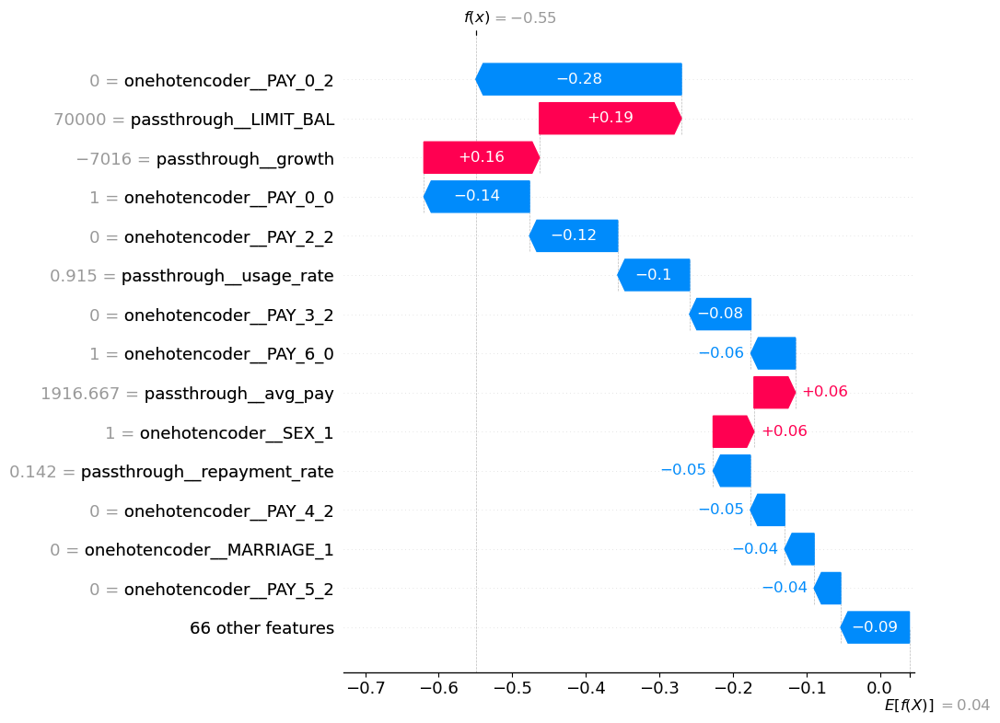

In [72]:
shap.initjs()
shap.plots.waterfall(xgb_explanation[ex_0_index, :], max_display = 15)

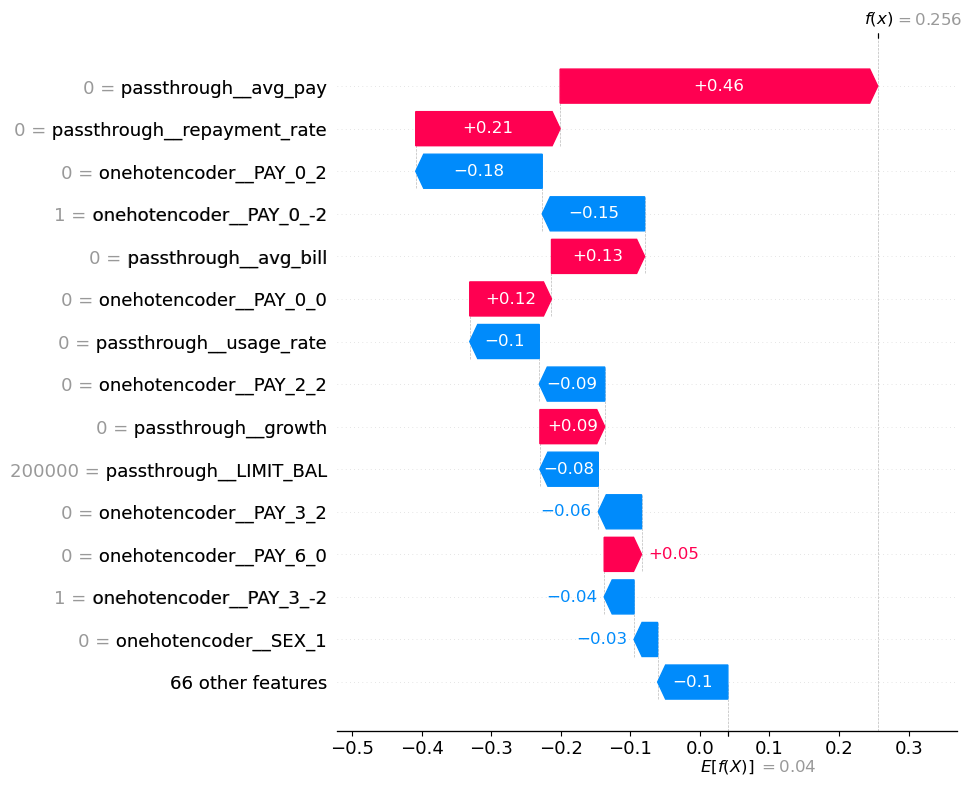

In [73]:
shap.plots.waterfall(xgb_explanation[ex_1_index, :], max_display = 15)

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 12. Results on the test set <a name="12"></a>
rubric={accuracy,reasoning}

**Your tasks:**

1. Try your best performing model on the test data and report test scores. 
2. Do the test scores agree with the validation scores from before? To what extent do you trust your results? Do you think you've had issues with optimization bias? 
3. Take one or two test predictions and explain them with SHAP force plots.  
    
</div>


_Points:_ 6

Based on the scores, the best XGBoosting model with best hyperparameters agree with the validation scores above. 
```
	f1	precision	recall	accuracy
    0.550181	0.496142	0.61743	0.772167


```
Since the F1 score is still 0.55, the model's credibility is not high, but the model does not have any optimization bias since we never violate the golden rule meanwhile the generalization of the model matches with the validation score.

Furthermore, for the shap force plots, I chose two observation point, one with target = 0 and one with target = 1, as we can see, the shap force plot gives quite accurate predictions, 

For the one with target = 0, the log odd of the observation is -0.37 which means that the model is more likely to classify the observation as 0 instead of 1, the dominant features are `pay_3` with value = 2, which push the log odd into minus side.

For the one with target = 1, the log odd of the observation is 0.91, which means that the model is more likely to classify the observation as 1 instead of 0, the dominant feature is `PAY_0` with value = 2 and `usage_rate`,which push the log odd into the positive side.


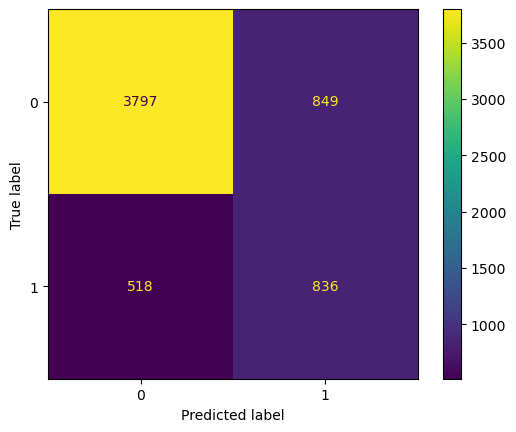

In [55]:
from sklearn.metrics import f1_score, accuracy_score, precision_score, recall_score, PrecisionRecallDisplay, RocCurveDisplay, confusion_matrix, ConfusionMatrixDisplay 

y_pred = best_pipe.predict(X_test_eng)
ConfusionMatrixDisplay.from_predictions(y_test, y_pred)

In [56]:
pd.DataFrame(
    {
        'f1': [f1_score(y_test, y_pred)],
        'precision': precision_score(y_test, y_pred),
        'recall': recall_score(y_test, y_pred),
        'accuracy': best_pipe.score(X_test_eng, y_test)
    }
)

,f1,precision,recall,accuracy
0,0.550181,0.496142,0.61743,0.772167


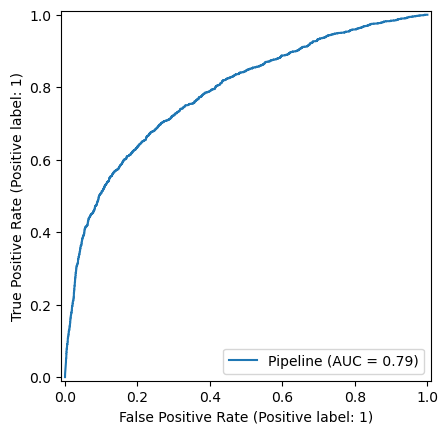

In [57]:
RocCurveDisplay.from_estimator(
    best_pipe,
    X_test_eng,
    y_test,
    pos_label = 1
);

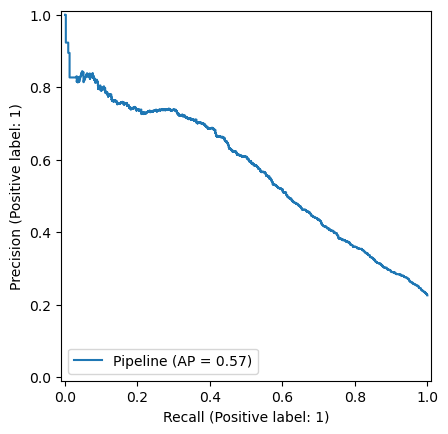

In [58]:
PrecisionRecallDisplay.from_estimator(
    best_pipe,
    X_test_eng,
    y_test,
    pos_label = 1,
);

In [59]:
shap.plots.force(xgb_explanation[0])

In [60]:
y_test.iloc[0]

np.int64(0)

In [61]:
shap.plots.force(xgb_explanation[2])

In [62]:
y_test.iloc[2]

np.int64(1)

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 13. Summary of results <a name="13"></a>
rubric={reasoning}

Imagine that you want to present the summary of these results to your boss and co-workers. 

**Your tasks:**

1. Create a table summarizing important results. 
2. Write concluding remarks.
3. Discuss other ideas that you did not try but could potentially improve the performance/interpretability . 
3. Report your final test score along with the metric you used at the top of this notebook.
    
</div>


_Points:_ 8

In this assignment, I tried multiple models including logistic regression model, SVC with RBF model, HistGradientBoosting Model, XGBoosting model. After feature engineering; Feature selection; Hyperparameter tunning, I found that the XGBoosting model provides the best F1 score. 

That said, the performance of the XGBoosting is still unsatisfying, 0.55 test f1 score means the model still has room to improve. Recall = 0.64 means that we only captures 64% of the default clients from all the default clients in the test set, while precision = 0.488 means among all the client we predicted will default, only 48.8% of them are the client who actually defaults.

I believe a more thothrough feature engineering will be a key to improve the performance, meanwhile, I am uncertain if LGBM will increase the performance or not.

In [ ]:
# Model table
pd.concat(cross_val_results, axis=1)

In [ ]:
# Validation score
pd.DataFrame(xgb_opt.cv_results_)[['mean_test_score', 'mean_train_score']].sort_values('mean_test_score', ascending = False).iloc[0]

In [ ]:
# Test Score
pd.DataFrame(
    {
        'f1': [f1_score(y_test, y_pred)],
        'precision': precision_score(y_test, y_pred),
        'recall': recall_score(y_test, y_pred),
        'accuracy': best_pipe.score(X_test_eng, y_test)
    }
)

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-warning">

## 14. Creating a data analysis pipeline (Challenging)
rubric={reasoning}

**Your tasks:**

- Convert this notebook into scripts to create a reproducible data analysis pipeline with appropriate documentation. Submit your project folder in addition to this notebook on GitHub and briefly comment on your organization in the text box below.
    
</div>


_Points:_ 0.5

_Type your answer here, replacing this text._

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-warning">

## 15. Your takeaway from the course (Challenging)
rubric={reasoning}

**Your tasks:**

What is your biggest takeaway from this course? 
    
</div>


_Points:_ 0.5

_Type your answer here, replacing this text._

<!-- END QUESTION -->

<div class="alert alert-danger" style="color:black">
    
**Restart, run all and export a PDF before submitting**
    
Before submitting,
don't forget to run all cells in your notebook
to make sure there are no errors
and so that the TAs can see your plots on Gradescope.
You can do this by clicking the ▶▶ button
or going to `Kernel -> Restart Kernel and Run All Cells...` in the menu.
This is not only important for MDS,
but a good habit you should get into before ever committing a notebook to GitHub,
so that your collaborators can run it from top to bottom
without issues.
    
After running all the cells,
export a PDF of the notebook (preferably the WebPDF export)
and upload this PDF together with the ipynb file to Gradescope
(you can select two files when uploading to Gradescope)
</div>

---

## Help us improve the labs

The MDS program is continually looking to improve our courses, including lab questions and content. The following optional questions will not affect your grade in any way nor will they be used for anything other than program improvement:

1. Approximately how many hours did you spend working or thinking about this assignment (including lab time)?

#Ans:

2. Do you have any feedback on the lab you be willing to share? For example, any part or question that you particularly liked or disliked?

#Ans:

## Submission

Make sure you have run all cells in your notebook in order before running the cell below, so that all images/graphs appear in the output. The cell below will generate a zip file for you to submit. **Please save before exporting!**

In [ ]:
# Save your notebook first, then run this cell to export your submission.
grader.export(run_tests=True)